In [151]:
from nltk import TreebankWordTokenizer, word_tokenize
import nltk
from nltk.corpus import stopwords
import gensim
from gensim.models import Word2Vec 
from bs4 import BeautifulSoup
from sklearn.metrics.pairwise import cosine_similarity
import glob
from pathlib import Path
import json
import re
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

In [2]:
with open('data/json_corpus', 'r') as corp_file:
    corpus_loaded = json.load(corp_file)

In [3]:
nltk.download('stopwords')
stopwords.words

[nltk_data] Downloading package stopwords to /home/josh/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


<bound method WordListCorpusReader.words of <WordListCorpusReader in '/home/josh/nltk_data/corpora/stopwords'>>

In [4]:
stop_words = stopwords.words('english')

In [13]:
#tokenize, lower

def tok_lower(doc):

    tokens = word_tokenize(doc)
    tokens = [t.lower() for t in tokens]
    return tokens




In [14]:
#here's a look inside a single tokenized and lowercased document
tok_lower(corpus_loaded[0])

['the',
 'russian',
 'tragedy',
 '(',
 'a',
 'review',
 'and',
 'an',
 'outlook',
 ')',
 'alexander',
 'berkman',
 'the',
 'russian',
 'tragedy',
 '(',
 'a',
 'review',
 'and',
 'an',
 'outlook',
 ')',
 '1922',
 'foreword',
 'i',
 'ii',
 'iii',
 'iv',
 'v',
 'foreword',
 'we',
 'live',
 'at',
 'a',
 'time',
 'when',
 'two',
 'civilisations',
 'are',
 'struggling',
 'for',
 'their',
 'existence',
 '.',
 'present',
 'society',
 'is',
 'at',
 'death',
 'grips',
 'with',
 'the',
 'new',
 'ideal',
 '.',
 'the',
 'russian',
 'revolution',
 'was',
 'but',
 'the',
 'first',
 'serious',
 'combat',
 'of',
 'the',
 'two',
 'forces',
 ',',
 'whose',
 'struggle',
 'must',
 'continue',
 'till',
 'the',
 'final',
 'triumph',
 'of',
 'the',
 'one',
 'or',
 'of',
 'the',
 'other',
 '.',
 'the',
 'russian',
 'revolution',
 'has',
 'failed',
 '—',
 'failed',
 'of',
 'its',
 'ultimate',
 'purpose',
 '.',
 'but',
 'that',
 'failure',
 'is',
 'a',
 'temporary',
 'one',
 '.',
 'in',
 'the',
 'point',
 'of',


In [15]:
# here's a way to test if this function is working the way I want without breaking the computer!


cleaned_corpus = []

dummy_counter = 0
for doc in corpus_loaded:
    dummy_counter += 1
    if dummy_counter > 500:
        break
    cleaned_corpus.append(tok_lower(doc))

In [9]:
#dummy_counter

101

In [16]:
#remove stop words
def stop_word_remover(list_of_lists):
    output_corpus = []
    for doc in list_of_lists:
        no_stops = [word for word in doc if word not in stop_words]
        output_corpus.append(no_stops)
    return output_corpus

In [17]:
clean_no_stops = stop_word_remover(cleaned_corpus)

In [18]:
clean_no_stops

[['russian',
  'tragedy',
  '(',
  'review',
  'outlook',
  ')',
  'alexander',
  'berkman',
  'russian',
  'tragedy',
  '(',
  'review',
  'outlook',
  ')',
  '1922',
  'foreword',
  'ii',
  'iii',
  'iv',
  'v',
  'foreword',
  'live',
  'time',
  'two',
  'civilisations',
  'struggling',
  'existence',
  '.',
  'present',
  'society',
  'death',
  'grips',
  'new',
  'ideal',
  '.',
  'russian',
  'revolution',
  'first',
  'serious',
  'combat',
  'two',
  'forces',
  ',',
  'whose',
  'struggle',
  'must',
  'continue',
  'till',
  'final',
  'triumph',
  'one',
  '.',
  'russian',
  'revolution',
  'failed',
  '—',
  'failed',
  'ultimate',
  'purpose',
  '.',
  'failure',
  'temporary',
  'one',
  '.',
  'point',
  'revolutionising',
  'thought',
  'feeling',
  'masses',
  'russia',
  'world',
  ',',
  'undermining',
  'fundamental',
  'concepts',
  'existing',
  'society',
  ',',
  'lighting',
  'torch',
  'faith',
  'hope',
  'better',
  'day',
  ',',
  'russian',
  'revolutio

In [19]:
#compare lengths after stop word removal
print(len(clean_no_stops[50]))
print(len(cleaned_corpus[50]))

print(len(clean_no_stops))
print(len(cleaned_corpus))


1304361
2158920
500
500


In [20]:
#just cycLe through and print decade

sample_doc = clean_no_stops[0]

year_pattern = r'\b\d{4}\b(?![–-]\d|\.\d)'
list_of_decades = []

def decade_extractor(sample_doc):
    label = []
    for token in sample_doc:
        if re.match(year_pattern, token):
            label = list(token)
            label[-1] = '0'
            label = "".join(label) #replace last character in year with 0
            break
    list_of_decades.append(label)


for doc in clean_no_stops:
    decade_extractor(doc)



'2010'

In [22]:
#this is an interesting sample document because it was breaking my regular expression from before
#"1870-1940" was getting extracted as the decade, it required a lookahead to anticipate(?) the dash.

print(clean_no_stops[49])
print(list_of_decades[49])

['anarchism', 'syndicalism', 'colonial', 'postcolonial', 'world', ',', '1870–1940', '|', 'anarchist', 'library', 'toggle', 'navigation', 'search', 'table', 'contents', 'archive', 'titles', 'authors', 'topics', 'latest', 'entries', 'popular', 'texts', 'add', 'new', 'text', 'project', 'live', 'chat', '(', 'irc/matrix', ')', 'tor', 'onion', 'services', 'bookshelf', '(', 'wiki', ')', 'donate', 'shh', '!', 'library', '!', '(', 'forums', ')', 'librarian', 'picks', 'languages', 'anarhistička', 'biblioteka', 'det', 'anarkistiske', 'bibliotek', '(', 'danish', ')', 'anarchistische', 'bibliothek', '(', 'german', ')', 'det', 'anarkistiska', 'biblioteket', '(', 'swedish', ')', 'bibliothèque', 'anarchiste', '(', 'french', ')', '아나키스트', '도서관', '(', 'korean', ')', 'библиотека', 'анархизма', '(', 'russian', ')', 'de', 'anarchistische', 'bibliotheek', '(', 'dutch', ')', 'анархистичка', 'библиотека', '(', 'macedonian', ')', 'biblioteca', 'anarchica', '(', 'italian', ')', 'η', 'αναρχική', 'βιβλιοθήκη', '(

In [23]:
#try to build and append decade to end of every token



year_pattern = r'\b\d{4}\b(?![–-]\d|\.\d)'

def decade_labeler(sample_doc):
    label = None
    doc_with_decade = []
    for token in doc:
        if re.match(year_pattern, token):
            label = list(token)
            label[-1] = '0'
            label = "".join(label) #replace last character in year with 0
            break
        else:
            label = "no_year"
    for token in doc:
        doc_with_decade.append(token + '_' + label)
    return doc_with_decade



In [24]:
labeled_corpus = []
for doc in clean_no_stops:
    labeled_corpus.append(decade_labeler(doc))

In [25]:
print(len(clean_no_stops))
print(len(labeled_corpus))

500
500


In [26]:
labeled_corpus

[['russian_1920',
  'tragedy_1920',
  '(_1920',
  'review_1920',
  'outlook_1920',
  ')_1920',
  'alexander_1920',
  'berkman_1920',
  'russian_1920',
  'tragedy_1920',
  '(_1920',
  'review_1920',
  'outlook_1920',
  ')_1920',
  '1922_1920',
  'foreword_1920',
  'ii_1920',
  'iii_1920',
  'iv_1920',
  'v_1920',
  'foreword_1920',
  'live_1920',
  'time_1920',
  'two_1920',
  'civilisations_1920',
  'struggling_1920',
  'existence_1920',
  '._1920',
  'present_1920',
  'society_1920',
  'death_1920',
  'grips_1920',
  'new_1920',
  'ideal_1920',
  '._1920',
  'russian_1920',
  'revolution_1920',
  'first_1920',
  'serious_1920',
  'combat_1920',
  'two_1920',
  'forces_1920',
  ',_1920',
  'whose_1920',
  'struggle_1920',
  'must_1920',
  'continue_1920',
  'till_1920',
  'final_1920',
  'triumph_1920',
  'one_1920',
  '._1920',
  'russian_1920',
  'revolution_1920',
  'failed_1920',
  '—_1920',
  'failed_1920',
  'ultimate_1920',
  'purpose_1920',
  '._1920',
  'failure_1920',
  'temp

In [ ]:
""""

ok, so i can find the year.

i could... label all the docs with the year and then do some sorting based on the labels i generate, but...
that seems like an extra step i don't need.

i could save the token as a new variable internal to the loop (or internal to the function) and...
generate lists based on novel increments of 10 years? (this seems hard and will produce decade folders i don't want)
or: i could auto-generate a list of folders x-present and fill them based on whether or not the year pattern matches a condition


i almost feel like the first option is better

"""

In [35]:
#build skipgram model
model_sg = Word2Vec(sentences=labeled_corpus, window=5, min_count=5, workers=4, epochs=5, sg=1)

In [83]:
#counts decades from input to 2020
def decade_to_present(start_decade):
    decades = []
    for i in range (start_decade, 2030, 10):
        decades.append(str(i))
    return decades

decade_to_present(1960)

['1960', '1970', '1980', '1990', '2000', '2010', '2020']

In [139]:
#find most similar terms from start decade to present
def term_over_time(term, start_decade):
    to_model = []
    output = []
    for dec in decade_to_present(start_decade):
        to_model.append(term + "_" + dec)
    for t in to_model:
            try:
                output.append(t[-4:] + ' top 5 ' + str(model_sg.wv.most_similar(t, topn=5)))
            except KeyError:
                 output.append(t[-4:] + ' term not present in decade')

    return output

term_over_time('marx', 1990)

["1990 top 5 [('vegetables_1990', 0.998725950717926), ('lie_1990', 0.9986596703529358), ('hegel_1990', 0.9986001253128052), ('confidence_1990', 0.9985085725784302), ('successes_1990', 0.9984954595565796)]",
 "2000 top 5 [('well_2000', 0.9934710264205933), ('see_2000', 0.9930881857872009), ('women_2000', 0.9927715063095093), ('like_2000', 0.9921993613243103), ('since_2000', 0.9921600222587585)]",
 "2010 top 5 [('bakunin_2010', 0.9665411114692688), ('engels_2010', 0.9653199315071106), ('proudhon_2010', 0.9574172496795654), ('kropotkin_2010', 0.9469538927078247), ('trotsky_2010', 0.9382555484771729)]",
 "2020 top 5 [('words_2020', 0.9987226724624634), ('1917_2020', 0.9987195730209351), ('second_2020', 0.9987094402313232), ('feeling_2020', 0.998651921749115), ('language_2020', 0.998549222946167)]"]

In [148]:
#track cosine similarity between two terms from start_decade to present

def relation_over_time(term1, term2, start_decade):
    to_model = []
    output = []
    for dec in decade_to_present(start_decade):
        to_model.append([term1 + "_" + dec, term2 + "_" + dec])
    for t1, t2 in to_model:
            try:
                output.append(model_sg.wv.similarity(t1, t2))
            except KeyError:
                 output.append(' term not present in decade')
    return output

relation_over_time('marx', 'said', 1990)

model_sg.wv.similarity(marx_2020, said_2020)

[0.99124724, 0.99041235, 0.9039784, 0.9954661]

<function matplotlib.pyplot.show(close=None, block=None)>

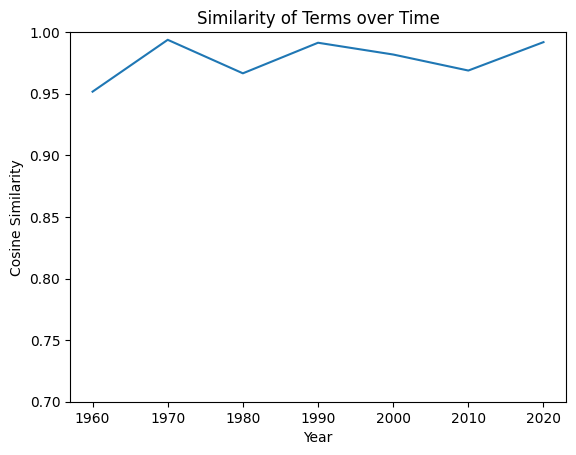

In [170]:
decades_for_plot = []
for dec in decade_to_present(1960):
    decades_for_plot.append(dec)
x = decades_for_plot
y = np.array(relation_over_time('worker', 'free', 1960))

plt.plot(x, y)
plt.ylim(0.7, 1)
plt.xlabel("Year")
plt.ylabel("Cosine Similarity")
plt.title("Similarity of Terms over Time")
plt.show


In [150]:
model_sg.wv.similarity('marx_2020', 'said_2020')

0.9954661

In [12]:
#ok, now let's do it for a few more docs and compare cosine cimilarity between two models?

In [ ]:

with open("/home/josh/Documents/a-library-nlp-project/theanarchistlibrary.org/library/zundlumpen-radical-left-i-m-breaking-up-with-you.html", "r") as file:
    html3 = file.read()
soup3 = BeautifulSoup(html3, "html.parser")
with open("/home/josh/Documents/a-library-nlp-project/theanarchistlibrary.org/library/zosia-brom-insert-topic-of-the-day-has-divided-anarchists.html", "r") as file:
    html4 = file.read()
soup4 = BeautifulSoup(html4, "html.parser")

#convert html to text
third_small_doc = soup3.get_text()
fourth_small_doc = soup4.get_text()

#this could be decade folders when i build this out
docs_next_corpus = []
docs_next_corpus.append(third_small_doc)
docs_next_corpus.append(fourth_small_doc)
len(docs_next_corpus)

docs_next_tokenized = []
for doc in docs_next_corpus:
    docs_next_tokenized.append(tokenizer.tokenize(doc))

model_sg_next = Word2Vec(sentences=docs_next_tokenized, window=5, min_count=3, workers=4, epochs=5, sg=1)
model_sg_next.wv.most_similar('the', topn=10)

In [ ]:
#finding a word that is in both doc lists to see top 10 most similar words
model_sg_next.wv.most_similar('political', topn=10)

In [ ]:
model_sg.wv.most_similar('political', topn=10)

In [16]:
#save the vectors for the same words in different corpora
vector_pol_1 = model_sg.wv['political']
vector_pol_2 = model_sg_next.wv['political']

vector_the_1 = model_sg.wv['the']
vector_the_2 = model_sg_next.wv['the']

In [17]:
#check structure of vector
#vector_pol_1

In [18]:
def reshape(vector):
    res = vector.reshape(1, -1)
    return res

In [19]:
vector_pol_1 = reshape(vector_pol_1)
vector_pol_2 = reshape(vector_pol_2)

In [ ]:
cosine_similarity(vector_pol_1, vector_pol_2)

In [21]:
vector_the_1 = reshape(vector_the_1)
vector_the_2 = reshape(vector_the_2)

In [ ]:
cosine_similarity(vector_the_1, vector_the_2)

In [ ]:
cosine_similarity(vector_the_1, vector_pol_1)

In [ ]:
model_sg.wv.similarity("the", "political")

In [18]:
""""
I thought I wanted to put docs into a dictionary, but now I think it's a bad idea


#find year.... and split into decades(?)

sample_doc = clean_no_stops[0]

decade_split_dict = {}
year_pattern = r'\b\d{4}\b(?![–-]\d|\.\d)'

def decade_extractor(sample_doc):
    label = []
    for token in sample_doc:
        if re.match(year_pattern, token):
            label = list(token)
            label[-1] = '0'
            label = "".join(label) #replace last character in year with 0
            break 
    if label in decade_split_dict:
        decade_split_dict[label] += sample_doc
    else:
        decade_split_dict[label] = sample_doc



decade_extractor(sample_doc)
decade_split_dict


"""

'"\nI thought I wanted to put docs into a dictionary, but now I think it\'s a bad idea\n\n\n#find year.... and split into decades(?)\n\nsample_doc = clean_no_stops[0]\n\ndecade_split_dict = {}\nyear_pattern = r\'\x08\\d{4}\x08(?![–-]\\d|\\.\\d)\'\n\ndef decade_extractor(sample_doc):\n    label = []\n    for token in sample_doc:\n        if re.match(year_pattern, token):\n            label = list(token)\n            label[-1] = \'0\'\n            label = "".join(label) #replace last character in year with 0\n            break \n    if label in decade_split_dict:\n        decade_split_dict[label] += sample_doc\n    else:\n        decade_split_dict[label] = sample_doc\n\n\n\ndecade_extractor(sample_doc)\ndecade_split_dict\n\n\n'